# Advanced Version w/ Freeze learning & Fine-tuning
For this approach, it will be used a pretrained DenseNet201, to which we will apply freeze learning and fine-tuning for our task.

In [1]:
import os

DATA_DIR = "../data/"
IMG_DIR = DATA_DIR + "/images/"
ANNOTATION_DIR = DATA_DIR + "/annotations/"
SPLITS_DIR = DATA_DIR + "/dl-split/"
OUT_DIR = "./out/advanced_scratch/"

os.makedirs(OUT_DIR, exist_ok=True)

SEED = 42

# Utility Function

In [21]:
import matplotlib.pyplot as plt
def plot_training_history(train_history, val_history, model_name, phase_name, out_dir):
    fig, (loss_ax, acc_ax) = plt.subplots(figsize=(12, 8), nrows=2)
    fig.suptitle(f"{model_name} - {phase_name} History")
    loss_ax.set_title("Binary Cross Entropy Loss")
    loss_ax.plot(train_history["loss"], label="train")
    loss_ax.plot(val_history["loss"], label="val")
    loss_ax.legend(loc="best")

    acc_ax.set_title("Classification accuracy")
    acc_ax.plot(train_history["accuracy"], label="train")
    acc_ax.plot(val_history["accuracy"], label="val")
    loss_ax.legend(loc="best")

    plt.tight_layout()

    fig.savefig(f"{out_dir}/{model_name}_{phase_name}_history.png", dpi=150, bbox_inches='tight')

    return fig

# Load Dataset

In [3]:
# Fetching pre-defined splits
train_split = []
test_split = []

with open(SPLITS_DIR + "/train.txt") as train_split_f:
    train_split = [line.strip("\n") for line in train_split_f.readlines()]

with open(SPLITS_DIR + "/test.txt") as test_split_f:
    test_split = [line.strip("\n") for line in test_split_f.readlines()]

In [4]:
# Label mapping
label_encode_map = {
    "trafficlight": 0,
    "speedlimit": 1,
    "crosswalk": 2,
    "stop": 3,
}

label_decode_map = {
    0: "trafficlight",
    1: "speedlimit",
    2: "crosswalk",
    3: "stop",
}

In [5]:
from datasets.road_sign_dataset import RoadSignDataset

# Training dataset
training_data = RoadSignDataset(
    img_names=train_split,
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=True,
    multilabel=True,
    obj_detection=False
)

# Test dataset
testing_data = RoadSignDataset(
    img_names=test_split,
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=False,
    multilabel=True,
    obj_detection=False
)

# Split training dataset into train and validation splits

In [6]:
import numpy as np
from torch.utils.data import SubsetRandomSampler

np.random.seed(SEED)

train_indices = list(range(len(training_data)))
np.random.shuffle(train_indices)
train_val_split = int(np.floor(0.2 * len(train_indices)))

train_idx, val_idx = train_indices[train_val_split:], train_indices[:train_val_split]
train_sampler = SubsetRandomSampler(train_idx)
val_sampler = SubsetRandomSampler(val_idx)

# Create Dataloaders

In [7]:
from torch.utils.data import DataLoader

BATCH_SIZE = 4 # Tested on 1050TI with 4GB (can load at least 64 as well, but doesn't make sense to use 64 with low amount of data)
NUM_WORKERS = 4

train_dataloader = DataLoader(
    dataset=training_data,
    sampler=train_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

val_dataloader = DataLoader(
    dataset=training_data,
    sampler=val_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

test_dataloader = DataLoader(
    dataset=testing_data,
    batch_size=1,
    num_workers=NUM_WORKERS,
    shuffle=False,
    drop_last=False,
    collate_fn=testing_data.collate_fn
)

# Model Definition

In [8]:
from torchvision import models
from torch import nn
from torchinfo import summary

MODEL_NAME = "ADVANCED_SCRATCH"
N_CLASSES = 4

def get_model(n_classes):
    model = models.densenet201(pretrained=False)
    in_features = model.classifier.in_features
    model.classifier = nn.Linear(
        in_features=in_features,
        out_features=n_classes,
        bias=True
    )

    return model

model = get_model(n_classes=N_CLASSES)

summary(model)

Layer (type:depth-idx)                   Param #
DenseNet                                 --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       9,408
│    └─BatchNorm2d: 2-2                  128
│    └─ReLU: 2-3                         --
│    └─MaxPool2d: 2-4                    --
│    └─_DenseBlock: 2-5                  --
│    │    └─_DenseLayer: 3-1             45,440
│    │    └─_DenseLayer: 3-2             49,600
│    │    └─_DenseLayer: 3-3             53,760
│    │    └─_DenseLayer: 3-4             57,920
│    │    └─_DenseLayer: 3-5             62,080
│    │    └─_DenseLayer: 3-6             66,240
│    └─_Transition: 2-6                  --
│    │    └─BatchNorm2d: 3-7             512
│    │    └─ReLU: 3-8                    --
│    │    └─Conv2d: 3-9                  32,768
│    │    └─AvgPool2d: 3-10              --
│    └─_DenseBlock: 2-7                  --
│    │    └─_DenseLayer: 3-11            53,760
│    │    └─_DenseLayer: 3-12     

# Define Optimizer, LR Scheduler, Loss function and Metric Scorer

In [9]:
from torch import optim
import torchmetrics

optimizer = optim.Adam(
    params=model.parameters(),
    lr=1e-3,
    betas=(0.9, 0.999),
    weight_decay=5e-4,
    amsgrad=True
)

lr_scheduler = optim.lr_scheduler.ExponentialLR(
    optimizer=optimizer,
    gamma=0.9
)

loss_fn = nn.BCELoss()

CLS_THRESHOLD = 0.5

metric_scorer = torchmetrics.Accuracy(
    threshold=CLS_THRESHOLD,
    num_classes=N_CLASSES,
    average="macro",
)

# Define Epoch Iteration

In [10]:
import torch
import torch.nn.functional as F
from tqdm import tqdm

def epoch_iter(dataloader, model, loss_fn, device, is_train = True, optimizer=None, lr_scheduler=None):
    if is_train:
        assert optimizer is not None, "When training, please provide an optimizer."
      
    num_batches = len(dataloader)

    if is_train:
        model.train()
    else:
        model.eval()

    probs = []
    preds = []
    expected_labels = []
    imageIds = []

    total_loss = 0.0

    with torch.set_grad_enabled(is_train):
        for _batch, (X, y) in enumerate(tqdm(dataloader)):
            labels = y["labels"]
            ids = y["imageIds"]

            X, y = X.to(device), labels.to(device)

            pred = model(X)
            prob = nn.Sigmoid()(pred)
            
            loss = loss_fn(prob, y.float())

            if is_train:
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
            
            total_loss += loss.item()

            final_pred = (prob > CLS_THRESHOLD).int()
            probs.extend(prob.detach().cpu().numpy())
            preds.extend(final_pred.detach().cpu().numpy())
            expected_labels.extend(y.detach().cpu().numpy())
            imageIds.extend([f"road{imageId}" for imageId in ids.detach().cpu().numpy()])

        if is_train and lr_scheduler is not None:
            lr_scheduler.step()

    return (expected_labels, preds, probs, imageIds), total_loss / num_batches

# Train Model

In [11]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print(f"Using device: {device}")

Using device: cuda:0


In [12]:
NUM_EPOCHS = 30

model.to(device)
# model.features.requires_grad_(False) # Freeze feature layer

train_history = {
    "loss": [],
    "accuracy": [],
}

val_history = {
    "loss": [],
    "accuracy": [],
}

best_val_loss = np.inf
best_val_accuracy = 0
best_epoch = -1

print(f"Starting {MODEL_NAME} training...")

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"Epoch[{epoch}/{NUM_EPOCHS}]")
    (train_target, train_preds, train_probs, _), train_loss = epoch_iter(
        dataloader=train_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=True,
        optimizer=optimizer,
        lr_scheduler=lr_scheduler
    )

    train_accuracy = metric_scorer(torch.tensor(np.array(train_probs)), torch.tensor(np.array(train_target))).item()
    print(f"Training loss: {train_loss:.3f}\t Training macro accuracy: {train_accuracy:.3f}")

    (val_target, val_preds, val_probs, _), val_loss = epoch_iter(
        dataloader=val_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=False,
    )

    val_accuracy = metric_scorer(torch.tensor(np.array(val_probs)), torch.tensor(np.array(val_target))).item()
    print(f"Validation loss: {val_loss:.3f}\t Validation macro accuracy: {val_accuracy:.3f}")

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_val_accuracy = val_accuracy
        best_epoch = epoch
        save_dict = {"model": model.state_dict(), "optimizer": optimizer.state_dict(), "lr_scheduler": lr_scheduler.state_dict(), "epoch": epoch}
        torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_best_model.pth")

    # Save latest model
    save_dict = {"model": model.state_dict(), "optimizer": optimizer.state_dict(), "lr_scheduler": lr_scheduler.state_dict(), "epoch": epoch}
    torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_latest_model.pth")

    # Save loss and accuracy in history
    train_history["loss"].append(train_loss)
    train_history["accuracy"].append(train_accuracy)

    val_history["loss"].append(val_loss)
    val_history["accuracy"].append(val_accuracy)

    print("----------------------------------------------------------------")

print(
    f"\nFinished training..."
    f"\nBest epoch: {best_epoch}\t Validation loss on best epoch: {best_val_loss}\t Accuracy on best epoch: {best_val_accuracy}"
)

Starting ADVANCED_SCRATCH training...
Epoch[1/30]


100%|██████████| 122/122 [00:43<00:00,  2.84it/s]


Training loss: 0.476	 Training macro accuracy: 0.822


100%|██████████| 30/30 [00:05<00:00,  5.59it/s]


Validation loss: 0.599	 Validation macro accuracy: 0.835
----------------------------------------------------------------
Epoch[2/30]


100%|██████████| 122/122 [00:39<00:00,  3.13it/s]


Training loss: 0.421	 Training macro accuracy: 0.843


100%|██████████| 30/30 [00:05<00:00,  5.87it/s]


Validation loss: 0.416	 Validation macro accuracy: 0.846
----------------------------------------------------------------
Epoch[3/30]


100%|██████████| 122/122 [00:38<00:00,  3.16it/s]


Training loss: 0.412	 Training macro accuracy: 0.848


100%|██████████| 30/30 [00:05<00:00,  5.79it/s]


Validation loss: 0.413	 Validation macro accuracy: 0.838
----------------------------------------------------------------
Epoch[4/30]


100%|██████████| 122/122 [00:39<00:00,  3.11it/s]


Training loss: 0.402	 Training macro accuracy: 0.851


100%|██████████| 30/30 [00:05<00:00,  5.28it/s]


Validation loss: 0.474	 Validation macro accuracy: 0.840
----------------------------------------------------------------
Epoch[5/30]


100%|██████████| 122/122 [00:39<00:00,  3.07it/s]


Training loss: 0.413	 Training macro accuracy: 0.840


100%|██████████| 30/30 [00:05<00:00,  5.70it/s]


Validation loss: 0.677	 Validation macro accuracy: 0.835
----------------------------------------------------------------
Epoch[6/30]


100%|██████████| 122/122 [00:38<00:00,  3.18it/s]


Training loss: 0.405	 Training macro accuracy: 0.845


100%|██████████| 30/30 [00:05<00:00,  5.88it/s]


Validation loss: 3.063	 Validation macro accuracy: 0.854
----------------------------------------------------------------
Epoch[7/30]


100%|██████████| 122/122 [00:38<00:00,  3.20it/s]


Training loss: 0.403	 Training macro accuracy: 0.847


100%|██████████| 30/30 [00:05<00:00,  5.79it/s]


Validation loss: 0.385	 Validation macro accuracy: 0.856
----------------------------------------------------------------
Epoch[8/30]


100%|██████████| 122/122 [00:37<00:00,  3.22it/s]


Training loss: 0.408	 Training macro accuracy: 0.847


100%|██████████| 30/30 [00:04<00:00,  6.00it/s]


Validation loss: 2.496	 Validation macro accuracy: 0.771
----------------------------------------------------------------
Epoch[9/30]


100%|██████████| 122/122 [00:37<00:00,  3.26it/s]


Training loss: 0.410	 Training macro accuracy: 0.844


100%|██████████| 30/30 [00:04<00:00,  6.01it/s]


Validation loss: 0.589	 Validation macro accuracy: 0.856
----------------------------------------------------------------
Epoch[10/30]


100%|██████████| 122/122 [00:37<00:00,  3.22it/s]


Training loss: 0.402	 Training macro accuracy: 0.845


100%|██████████| 30/30 [00:05<00:00,  5.88it/s]


Validation loss: 0.389	 Validation macro accuracy: 0.846
----------------------------------------------------------------
Epoch[11/30]


100%|██████████| 122/122 [00:38<00:00,  3.20it/s]


Training loss: 0.404	 Training macro accuracy: 0.853


100%|██████████| 30/30 [00:04<00:00,  6.06it/s]


Validation loss: 0.365	 Validation macro accuracy: 0.858
----------------------------------------------------------------
Epoch[12/30]


100%|██████████| 122/122 [00:38<00:00,  3.15it/s]


Training loss: 0.404	 Training macro accuracy: 0.844


100%|██████████| 30/30 [00:05<00:00,  5.46it/s]


Validation loss: 0.394	 Validation macro accuracy: 0.848
----------------------------------------------------------------
Epoch[13/30]


100%|██████████| 122/122 [00:38<00:00,  3.20it/s]


Training loss: 0.399	 Training macro accuracy: 0.846


100%|██████████| 30/30 [00:05<00:00,  5.85it/s]


Validation loss: 0.425	 Validation macro accuracy: 0.842
----------------------------------------------------------------
Epoch[14/30]


100%|██████████| 122/122 [00:39<00:00,  3.08it/s]


Training loss: 0.406	 Training macro accuracy: 0.842


100%|██████████| 30/30 [00:05<00:00,  5.37it/s]


Validation loss: 0.593	 Validation macro accuracy: 0.848
----------------------------------------------------------------
Epoch[15/30]


100%|██████████| 122/122 [00:38<00:00,  3.14it/s]


Training loss: 0.395	 Training macro accuracy: 0.846


100%|██████████| 30/30 [00:05<00:00,  5.89it/s]


Validation loss: 0.571	 Validation macro accuracy: 0.842
----------------------------------------------------------------
Epoch[16/30]


100%|██████████| 122/122 [00:38<00:00,  3.19it/s]


Training loss: 0.380	 Training macro accuracy: 0.857


100%|██████████| 30/30 [00:05<00:00,  5.73it/s]


Validation loss: 0.426	 Validation macro accuracy: 0.846
----------------------------------------------------------------
Epoch[17/30]


100%|██████████| 122/122 [00:39<00:00,  3.08it/s]


Training loss: 0.395	 Training macro accuracy: 0.850


100%|██████████| 30/30 [00:05<00:00,  5.52it/s]


Validation loss: 0.446	 Validation macro accuracy: 0.833
----------------------------------------------------------------
Epoch[18/30]


100%|██████████| 122/122 [00:41<00:00,  2.95it/s]


Training loss: 0.383	 Training macro accuracy: 0.852


100%|██████████| 30/30 [00:05<00:00,  5.43it/s]


Validation loss: 0.357	 Validation macro accuracy: 0.867
----------------------------------------------------------------
Epoch[19/30]


100%|██████████| 122/122 [00:39<00:00,  3.08it/s]


Training loss: 0.390	 Training macro accuracy: 0.853


100%|██████████| 30/30 [00:05<00:00,  5.73it/s]


Validation loss: 0.392	 Validation macro accuracy: 0.852
----------------------------------------------------------------
Epoch[20/30]


100%|██████████| 122/122 [00:39<00:00,  3.13it/s]


Training loss: 0.381	 Training macro accuracy: 0.859


100%|██████████| 30/30 [00:04<00:00,  6.17it/s]


Validation loss: 3.288	 Validation macro accuracy: 0.802
----------------------------------------------------------------
Epoch[21/30]


100%|██████████| 122/122 [00:38<00:00,  3.18it/s]


Training loss: 0.382	 Training macro accuracy: 0.853


100%|██████████| 30/30 [00:05<00:00,  5.61it/s]


Validation loss: 0.411	 Validation macro accuracy: 0.854
----------------------------------------------------------------
Epoch[22/30]


100%|██████████| 122/122 [00:42<00:00,  2.87it/s]


Training loss: 0.401	 Training macro accuracy: 0.844


100%|██████████| 30/30 [00:05<00:00,  5.33it/s]


Validation loss: 0.438	 Validation macro accuracy: 0.860
----------------------------------------------------------------
Epoch[23/30]


100%|██████████| 122/122 [00:42<00:00,  2.85it/s]


Training loss: 0.405	 Training macro accuracy: 0.841


100%|██████████| 30/30 [00:05<00:00,  5.45it/s]


Validation loss: 0.379	 Validation macro accuracy: 0.867
----------------------------------------------------------------
Epoch[24/30]


100%|██████████| 122/122 [00:40<00:00,  3.03it/s]


Training loss: 0.389	 Training macro accuracy: 0.851


100%|██████████| 30/30 [00:05<00:00,  5.70it/s]


Validation loss: 0.372	 Validation macro accuracy: 0.871
----------------------------------------------------------------
Epoch[25/30]


100%|██████████| 122/122 [00:38<00:00,  3.17it/s]


Training loss: 0.379	 Training macro accuracy: 0.851


100%|██████████| 30/30 [00:05<00:00,  5.70it/s]


Validation loss: 0.406	 Validation macro accuracy: 0.850
----------------------------------------------------------------
Epoch[26/30]


100%|██████████| 122/122 [00:42<00:00,  2.85it/s]


Training loss: 0.380	 Training macro accuracy: 0.852


100%|██████████| 30/30 [00:05<00:00,  5.67it/s]


Validation loss: 0.501	 Validation macro accuracy: 0.833
----------------------------------------------------------------
Epoch[27/30]


100%|██████████| 122/122 [00:42<00:00,  2.86it/s]


Training loss: 0.386	 Training macro accuracy: 0.853


100%|██████████| 30/30 [00:05<00:00,  5.83it/s]


Validation loss: 0.424	 Validation macro accuracy: 0.854
----------------------------------------------------------------
Epoch[28/30]


100%|██████████| 122/122 [00:42<00:00,  2.87it/s]


Training loss: 0.383	 Training macro accuracy: 0.852


100%|██████████| 30/30 [00:05<00:00,  5.81it/s]


Validation loss: 0.360	 Validation macro accuracy: 0.863
----------------------------------------------------------------
Epoch[29/30]


100%|██████████| 122/122 [00:42<00:00,  2.85it/s]


Training loss: 0.378	 Training macro accuracy: 0.851


100%|██████████| 30/30 [00:05<00:00,  5.82it/s]


Validation loss: 0.370	 Validation macro accuracy: 0.863
----------------------------------------------------------------
Epoch[30/30]


100%|██████████| 122/122 [00:43<00:00,  2.81it/s]


Training loss: 0.378	 Training macro accuracy: 0.850


100%|██████████| 30/30 [00:05<00:00,  5.49it/s]


Validation loss: 0.378	 Validation macro accuracy: 0.852
----------------------------------------------------------------

Finished training...
Best epoch: 18	 Validation loss on best epoch: 0.35722890198230745	 Accuracy on best epoch: 0.8666666746139526


C:\Users\Ivo Saavedra\AppData\Local\Temp\ipykernel_7868\193648876.py:2: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


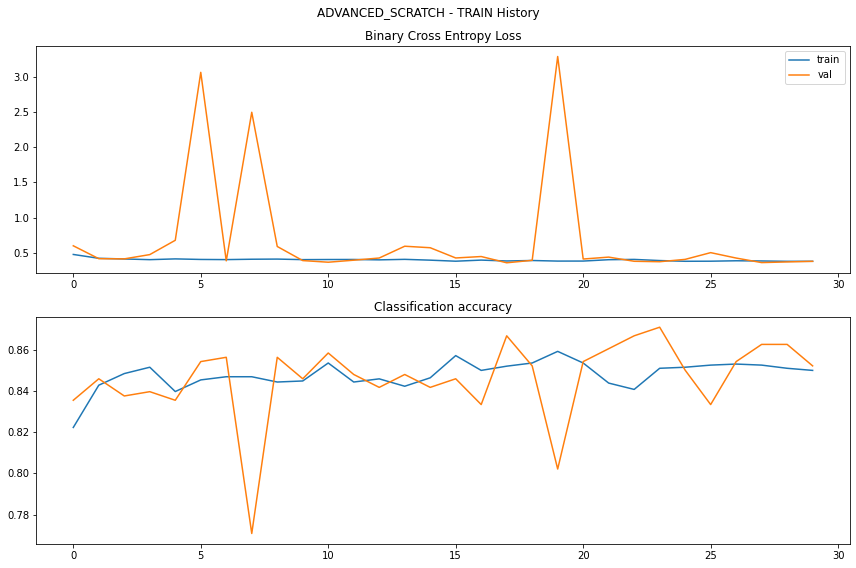

In [22]:
fig = plot_training_history(train_history=train_history, val_history=val_history, model_name=MODEL_NAME, phase_name="TRAIN", out_dir=OUT_DIR)
fig.show()

Clear GPU memory for guarantees

In [14]:
import gc
model = None

gc.collect()
torch.cuda.empty_cache()
torch.cuda.mem_get_info(device)

(785943758, 2147221504)

In [15]:
!nvidia-smi

Mon Jun  6 22:32:54 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 512.95       Driver Version: 512.95       CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:05:00.0  On |                  N/A |
| 29%   58C    P0    37W /  99W |   1146MiB /  2048MiB |      1%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Test the Model

In [16]:
best_checkpoint = torch.load(f"{OUT_DIR}/{MODEL_NAME}_best_model.pth")
model = get_model(n_classes=N_CLASSES)
model.load_state_dict(best_checkpoint["model"])
best_checkpoint = None

model.to(device)


print("Loaded best fine-tuned model...")

Loaded best fine-tuned model...


In [17]:
(test_target, test_preds, test_probs, test_ids), test_loss = epoch_iter(
    dataloader=test_dataloader,
    model=model,
    loss_fn=loss_fn,
    device=device,
    is_train=False,
)

100%|██████████| 264/264 [00:17<00:00, 15.52it/s]


In [18]:
test_metrics = torchmetrics.MetricCollection(
    metrics={
        "macro_accuracy": metric_scorer,
        "confusin_matrix": torchmetrics.ConfusionMatrix(
            threshold=CLS_THRESHOLD,
            num_classes=N_CLASSES,
            multilabel=True
        ),
        "macro_f1_score": torchmetrics.F1Score(
            threshold=CLS_THRESHOLD,
            num_classes=N_CLASSES,
            average="macro",
        )
    }
)

test_probs_tensor = torch.tensor(np.array(test_probs))
test_target_tensor = torch.tensor(np.array(test_target))

test_metrics_scores = test_metrics(test_probs_tensor, test_target_tensor)

print(test_metrics_scores)

{'confusin_matrix': tensor([[[233,   0],
         [ 31,   0]],

        [[ 25,  35],
         [  9, 195]],

        [[213,   0],
         [ 51,   0]],

        [[230,   7],
         [ 19,   8]]]), 'macro_accuracy': tensor(0.8561), 'macro_f1_score': tensor(0.3199)}


In [19]:
from PIL import Image
def showErrors(imageIds, y_true, y_pred, limit=None, img_dir = "./", out_dir = "./", model_name = "model"):
    N = limit if limit is not None else len(imageIds)
    N_COLS = 4
    N_ROWS = N // 4 + N % 4
    shown = 0
    fig = plt.figure(figsize=(8*N_COLS, 12*N_ROWS))
    for (imageId, correct, predicted) in zip(imageIds, y_true, y_pred):
        # Exact Match
        if np.all(correct == predicted):
            continue

        if shown >= N:
            shown += 1
            continue
        image = np.array(Image.open(f"{img_dir}/{imageId}.png").convert("RGB"))
        target_label = f"TRUE: {[label_decode_map[idx] if label else 'None' for idx, label in enumerate(correct)]}"
        predicted_label = f"PRED: {[label_decode_map[idx] if label else 'None' for idx, label in enumerate(predicted)]}"

        ax = fig.add_subplot(N_ROWS, N_COLS, shown + 1)
        ax.axis("off")
        ax.text(0, -8, imageId, fontsize=14, color="black")
        ax.text((len(imageId) + 1) * 8, -24, target_label, fontsize=13, color='green') # correct
        ax.text((len(imageId) + 1) * 8, -8, predicted_label, fontsize=13, color='red')  # predicted
        ax.imshow(image)

        shown += 1
        

    print(f"Total Errors: {shown}")
    plt.tight_layout()
    #fig.savefig(f"{out_dir}/{model_name}_errors.png", dpi=150, bbox_inches='tight')
    plt.show()

In [20]:
showErrors(test_ids, test_target, test_preds, limit=None, img_dir=IMG_DIR, out_dir=OUT_DIR, model_name=MODEL_NAME)

Total Errors: 93
